In [11]:
from tomoSegmentPipeline.utils.common import read_array, write_array
from tomoSegmentPipeline.utils import setup

import numpy as np
import matplotlib.pyplot as plt
import random
import mrcfile
import pandas as pd
import torch
import os
from glob import glob
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import normalized_mutual_information as nmi
from scipy import ndimage

PARENT_PATH = setup.PARENT_PATH
ISONET_PATH = os.path.join(PARENT_PATH, 'data/isoNet/')

def clip_and_standardize(X, low=0.005, high=0.995, quantiles=True):
    if quantiles:
        X_clp = np.clip(X, np.quantile(X, low), np.quantile(X, high))
    else:
        X_clp = np.clip(X, low, high)
    X_stdz = (X_clp-np.mean(X_clp))/np.std(X_clp)
    
    return X_stdz

%matplotlib inline
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

def plot_tomoFFT_planes(tomo_data, mw_tomoData, mw_tomoFft):
    
    """
    - Plot XY, ZX, YZ planes (left out coordinate at center) of the given tomograms with their corresponding FT spectrums.
    - Plot normal vs corrupted for XY and ZX
    """
    tomo_shape = tomo_data.shape
    
    # log_power_data = np.log(np.abs(np.fft.fftshift(tomo_fft))**2)
    mw_log_power_data = np.log(np.abs(mw_tomoFft)**2)

    fig, ax = plt.subplots(3, 2, figsize=(18, 11), gridspec_kw={'height_ratios': [2, 1, 1]})  
    plt.tight_layout()

    ax[0][0].imshow(mw_tomoData[tomo_shape[0]//2])
    ax[0][0].set_title('Image XY')

    ax[0][1].imshow(mw_log_power_data[tomo_shape[0]//2])
    ax[0][1].set_title('Corresponding Power Spectrum')

    ax[1][0].imshow(mw_tomoData[:, tomo_shape[1]//2, :])
    ax[1][0].set_title('Image ZX')

    ax[1][1].imshow(mw_log_power_data[:, tomo_shape[1]//2, :])
    ax[1][1].set_title('Corresponding Power Spectrum')

    ax[2][0].imshow(mw_tomoData[:, :, tomo_shape[2]//2])
    ax[2][0].set_title('Image ZY')

    ax[2][1].imshow(mw_log_power_data[:, :, tomo_shape[2]//2])
    ax[2][1].set_title('Corresponding Power Spectrum')

    plt.show()
    
    print('----------------------------------------------------------------------------------------------------------------------------------------------------------------')
    
    fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
    plt.tight_layout()

    ax[0].imshow(tomo_data[tomo_shape[0]//2])
    ax[0].set_title('Image XY')

    ax[1].imshow(mw_tomoData[tomo_shape[0]//2])
    ax[1].set_title('Missing wedge version XY')
    
    plt.show()
    
    print('----------------------------------------------------------------------------------------------------------------------------------------------------------------')
    fig, ax = plt.subplots(1, 2, figsize=(18, 11))  
    plt.tight_layout()

    ax[0].imshow(tomo_data[:, tomo_shape[1]//2, :])
    ax[0].set_title('Image ZX')

    ax[1].imshow(mw_tomoData[:, tomo_shape[1]//2, :])
    ax[1].set_title('Missing wedge version ZX')
    
    return

########### create cross ##################

def create_zeroCross(p0, dp, x_shape, y_shape):
    """
    p0: starting point of the wedge
    dp: width of the wedge (in degrees)
    """

    # at first the mask does nothing
    msk_mesh = np.ones_like(np.real(cet[:, 0, :]))

    # values within this angles belong to the part we want to set to zero
    angles0 = np.array([p0, p0+dp])
    angles0 = np.deg2rad(angles0)

    angles1 = np.array([180+p0, 180+p0+dp])
    angles1 = np.deg2rad(angles1)

    angles = []

    for zidx, z in enumerate(range(-y_shape//2, y_shape//2)):
        for xidx, x in enumerate(range(-x_shape//2, x_shape//2)):
            
            phi = np.arctan2(z, x)
            # make angles between 0 and 2*pi
            if phi<0:
                phi = phi+2*np.pi
            for i in range(2):
                if angles0[i]<0:
                    angles0[i] = angles0[i]+2*np.pi
                if angles1[i]<0:
                    angles1[i] = angles1[i]+2*np.pi

            angles.append(phi)

            cond0 = phi >= angles0[0] and phi < angles0[1]
            cond1 = phi >= angles1[0] and phi < angles1[1]

            # whenever a value is inside the missing wedge region, we mask it out
            if cond0 or cond1:
                msk_mesh[zidx, xidx] = 0

    msk_mesh *= np.flip(msk_mesh, axis=1)
    
    return msk_mesh

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Fourier Coefficients raw cET: spinach cells

## Full tomogram

In [2]:
# cet = os.path.join(PARENT_PATH, 'data/raw_cryo-ET/tomo32.mrc')
cet_path = os.path.join(ISONET_PATH, 'RAW_dataset/RAW_tomos_deconv/tomo32.mrc')
cet = clip_and_standardize(read_array(cet_path))

tomo_shape = cet.shape

print(tomo_shape)

(464, 928, 928)


In [3]:
fft_cet = np.fft.fftshift(np.fft.fftn(cet))
logPower_cet = np.log(np.abs(fft_cet)**2)
logPower_cet = clip_and_standardize(logPower_cet, low=0.001, high=0.999)

(array([3.14432100e+06, 1.98404190e+07, 8.76255290e+07, 1.19859307e+08,
        8.10424800e+07, 4.41871440e+07, 2.20537620e+07, 1.25425340e+07,
        6.41780600e+06, 2.87607400e+06]),
 array([-2.54034845e+00, -1.90475421e+00, -1.26915998e+00, -6.33565748e-01,
         2.02848524e-03,  6.37622719e-01,  1.27321695e+00,  1.90881119e+00,
         2.54440542e+00,  3.17999965e+00,  3.81559389e+00]),
 <BarContainer object of 10 artists>)

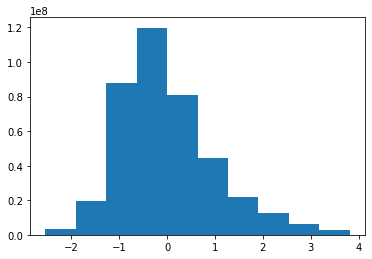

In [68]:
plt.hist(logPower_cet.flatten())

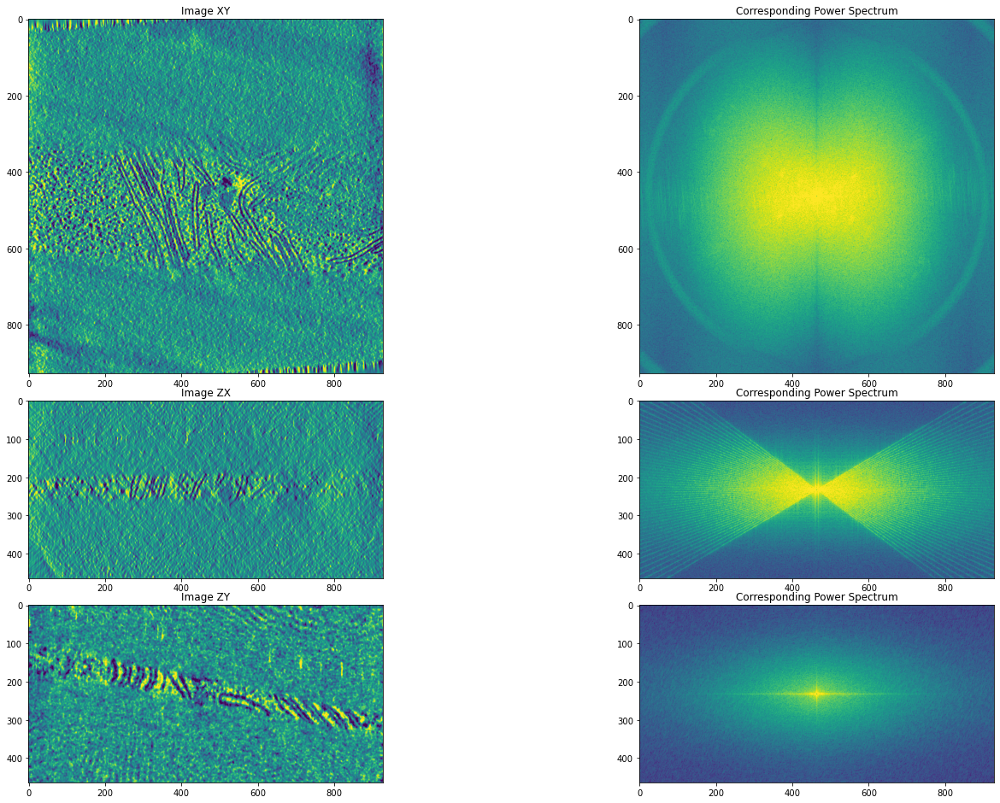

In [69]:
tomo_shape = cet.shape

fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_cet[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_cet[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_cet[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

(array([ 1663.,  5816., 24360., 65709., 64981., 55692., 89564., 71804.,
        36331., 14672.]),
 array([-2.93749298, -2.40624421, -1.87499545, -1.34374669, -0.81249792,
        -0.28124916,  0.2499996 ,  0.78124836,  1.31249713,  1.84374589,
         2.37499465]),
 <BarContainer object of 10 artists>)

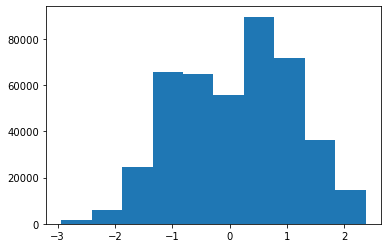

In [ ]:
plt.hist(logPower_cet[:, tomo_shape[1]//2, :].flatten())

(array([7.50000e+01, 2.26000e+02, 1.13800e+03, 5.33800e+03, 2.41580e+04,
        8.67880e+04, 2.13350e+05, 3.07042e+05, 2.01439e+05, 2.16300e+04]),
 array([-2.93749298, -2.40624421, -1.87499545, -1.34374669, -0.81249792,
        -0.28124916,  0.2499996 ,  0.78124836,  1.31249713,  1.84374589,
         2.37499465]),
 <BarContainer object of 10 artists>)

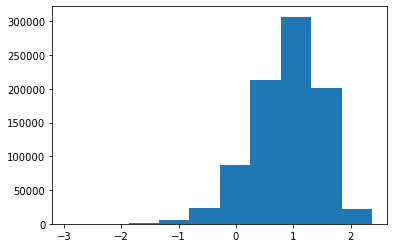

In [ ]:
plt.hist(logPower_cet[tomo_shape[0]//2].flatten())

## FFT distribution on Annulus

In [4]:
tomo_shape = cet.shape

yidx = tomo_shape[1]//2
annulus_mesh = np.zeros_like(cet[:, 0, :])

angles = []
logPower_list = []
power_list = []
rs = []

delta_r = 1

annulus_inner = 15
annulus_outer = annulus_inner+delta_r

for zidx, z in enumerate(range(-tomo_shape[0]//2, tomo_shape[0]//2)):
    for xidx, x in enumerate(range(-tomo_shape[2]//2, tomo_shape[2]//2)):
        r = np.linalg.norm([z, x])
        
        phi = np.arctan2(z, x)
        phi = (2*np.pi+phi)%(2*np.pi)
        
        if r>annulus_inner and r<annulus_outer:
            annulus_mesh[zidx, xidx] = 1
            angles.append(phi)
            lp = logPower_cet[zidx, yidx, xidx]
            logPower_list.append(lp)
            power_list.append(np.exp(lp))

(array([ 6.,  0.,  0.,  2.,  4.,  0.,  2.,  0.,  0.,  0.,  0.,  4.,  0.,
         0.,  6.,  0.,  0.,  4.,  4.,  4.,  0.,  6.,  2.,  0.,  2.,  2.,
         4.,  0.,  0., 32.]),
 array([10.11823534, 11.29441793, 12.47060051, 13.6467831 , 14.82296569,
        15.99914828, 17.17533087, 18.35151345, 19.52769604, 20.70387863,
        21.88006122, 23.05624381, 24.2324264 , 25.40860898, 26.58479157,
        27.76097416, 28.93715675, 30.11333934, 31.28952193, 32.46570451,
        33.6418871 , 34.81806969, 35.99425228, 37.17043487, 38.34661745,
        39.52280004, 40.69898263, 41.87516522, 43.05134781, 44.2275304 ,
        45.40371298]),
 <BarContainer object of 30 artists>)

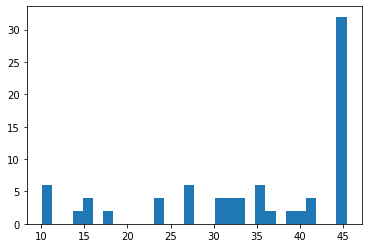

In [5]:
# Magnitude of the coefficients do not follow a Rayleigh distribution in our case
plt.hist(power_list, bins=30)

(array([ 2.,  4.,  0.,  0.,  0.,  0.,  0.,  4.,  0.,  2.,  0.,  2.,  0.,
         0.,  0.,  0.,  4.,  0.,  0.,  6.,  0.,  0.,  8.,  4.,  4.,  4.,
         2.,  2.,  4., 32.]),
 array([2.31433927, 2.3643811 , 2.41442292, 2.46446474, 2.51450656,
        2.56454838, 2.6145902 , 2.66463202, 2.71467384, 2.76471566,
        2.81475748, 2.8647993 , 2.91484112, 2.96488294, 3.01492476,
        3.06496658, 3.1150084 , 3.16505022, 3.21509204, 3.26513386,
        3.31517568, 3.3652175 , 3.41525932, 3.46530114, 3.51534296,
        3.56538478, 3.6154266 , 3.66546842, 3.71551024, 3.76555207,
        3.81559389]),
 <BarContainer object of 30 artists>)

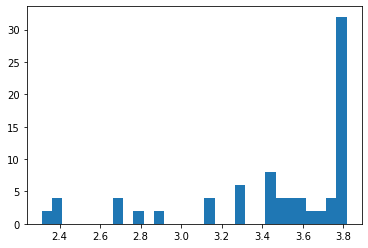

In [6]:
plt.hist(logPower_list, bins=30)

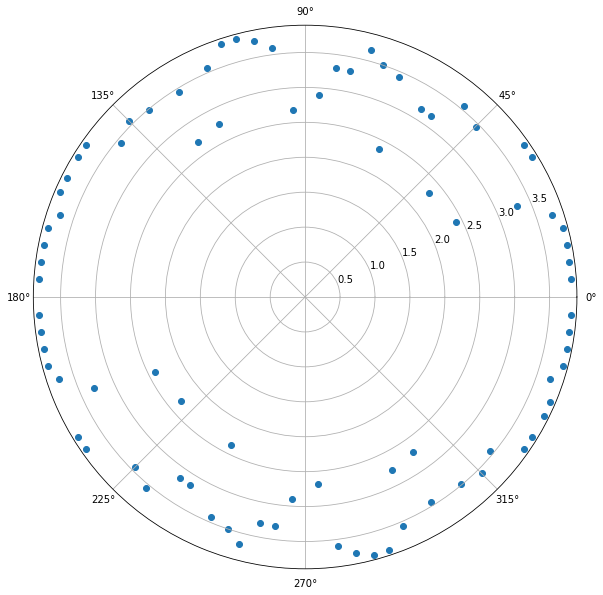

In [7]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(12,10))
ax.scatter(angles, logPower_list)
ax.grid(True)
plt.show()

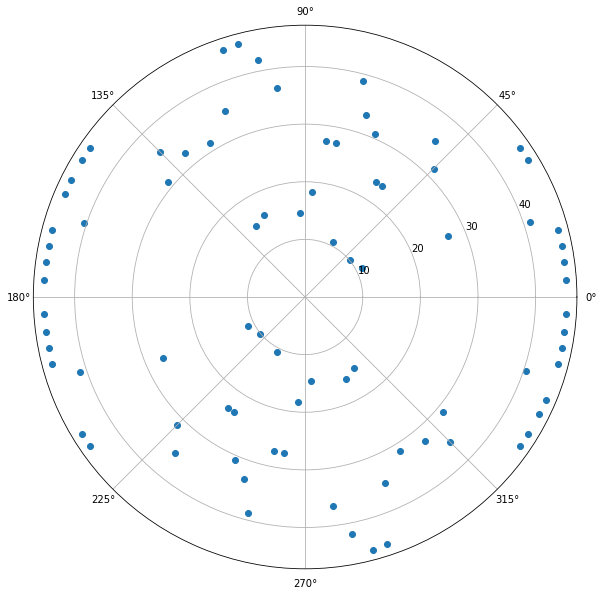

In [8]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(12,10))
ax.scatter(angles, power_list)
ax.grid(True)
plt.show()

In [9]:
aux = logPower_cet[:, yidx, :]*annulus_mesh

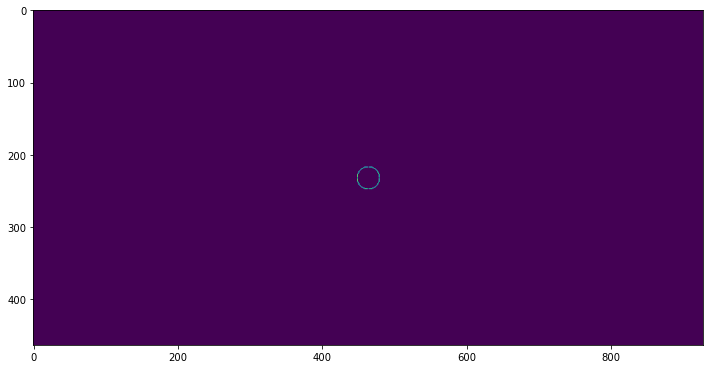

In [10]:
plt.figure(figsize=(12, 10))
plt.imshow(aux)

## Low power filtering

In [4]:
power_cet = np.exp(logPower_cet)

(array([3.66021312e+08, 1.86584320e+07, 6.59951200e+06, 3.23341000e+06,
        1.82495200e+06, 1.11603000e+06, 7.21014000e+05, 4.78114000e+05,
        3.20952000e+05, 6.15648000e+05]),
 array([ 0.07883892,  4.61132633,  9.14381374, 13.67630114, 18.20878855,
        22.74127595, 27.27376336, 31.80625077, 36.33873817, 40.87122558,
        45.40371298]),
 <BarContainer object of 10 artists>)

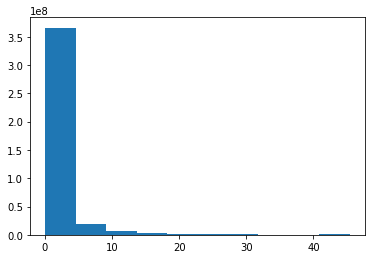

In [5]:
plt.hist(power_cet.flatten())

In [7]:
mask = (power_cet>np.quantile(power_cet, 0.1)).astype(int)
logPower_filtered = mask*logPower_cet


fft_filtered = mask*fft_cet
cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

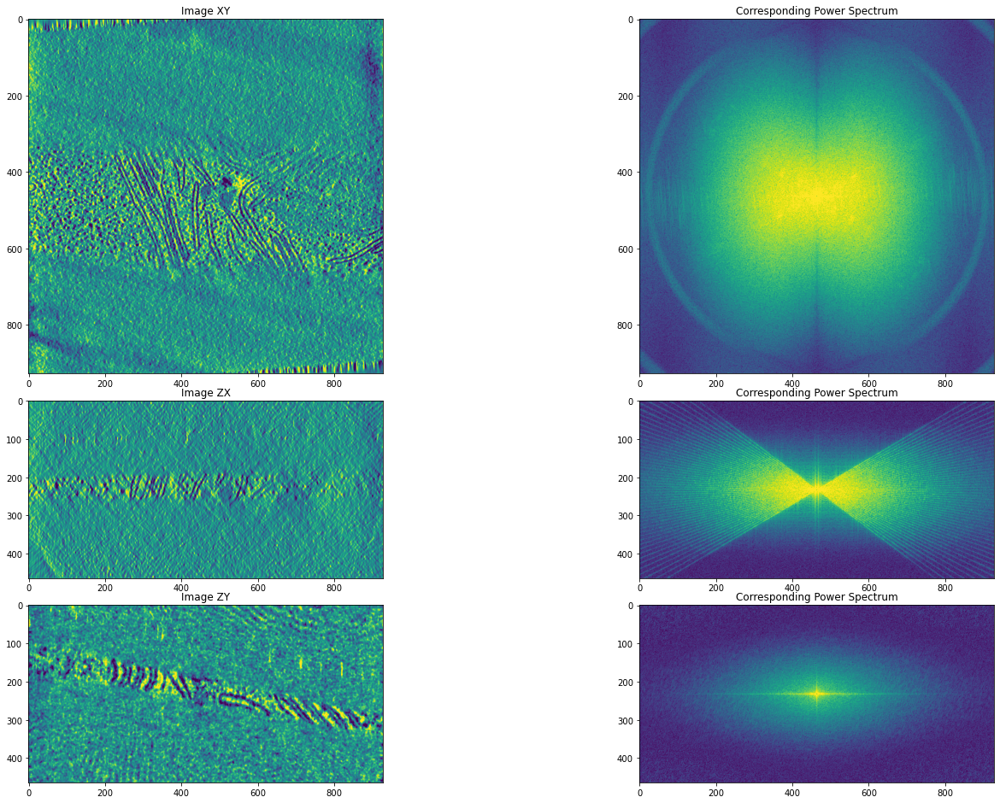

In [8]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

In [9]:
mask = (power_cet>np.quantile(power_cet, 0.5)).astype(int)
logPower_filtered = mask*logPower_cet

fft_filtered = mask*fft_cet
cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

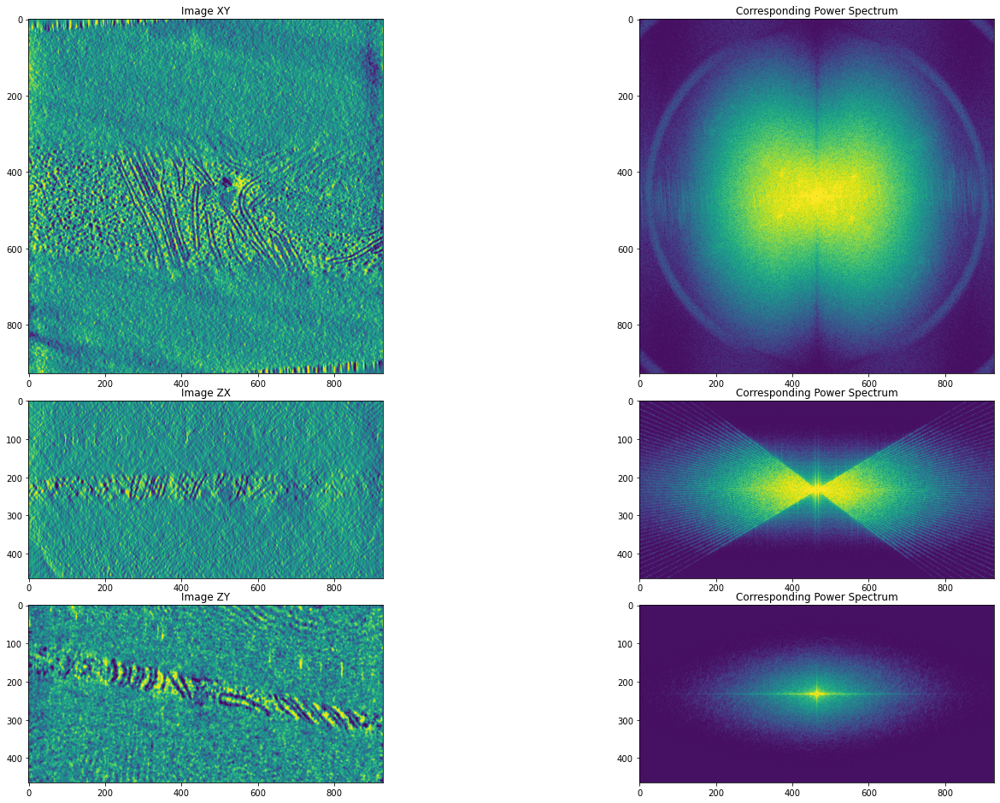

In [10]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Only using low frequency parts of the spectrum to reconstruct image 

In [15]:
mask = np.zeros_like(cet)
mask[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4] = 1

logPower_filtered = mask*logPower_cet

fft_filtered = mask*fft_cet

# logPower_filtered = logPower_cet[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4]

# fft_filtered = fft_cet[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4]
cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

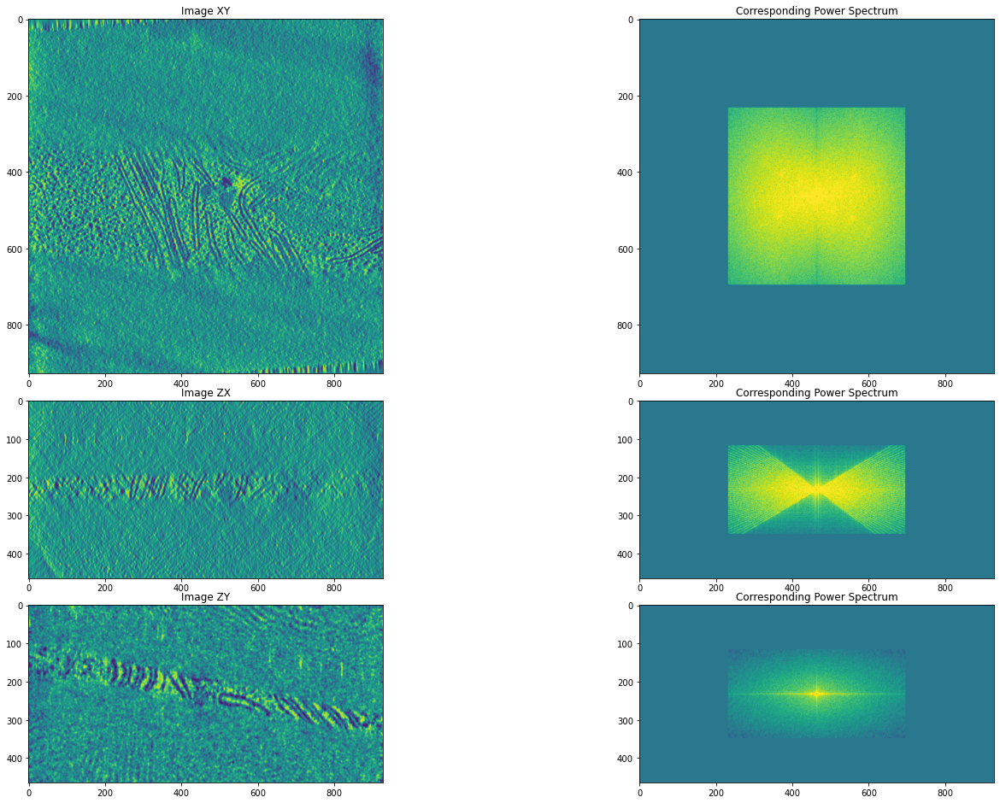

In [16]:
tomo_shape2 = cet_filtered.shape
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape2[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape2[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape2[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape2[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape2[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape2[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Only using high frequency parts of the spectrum to reconstruct image 

In [13]:
mask = np.ones_like(cet)
mask[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4] = 0

logPower_filtered = mask*logPower_cet

fft_filtered = mask*fft_cet
cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

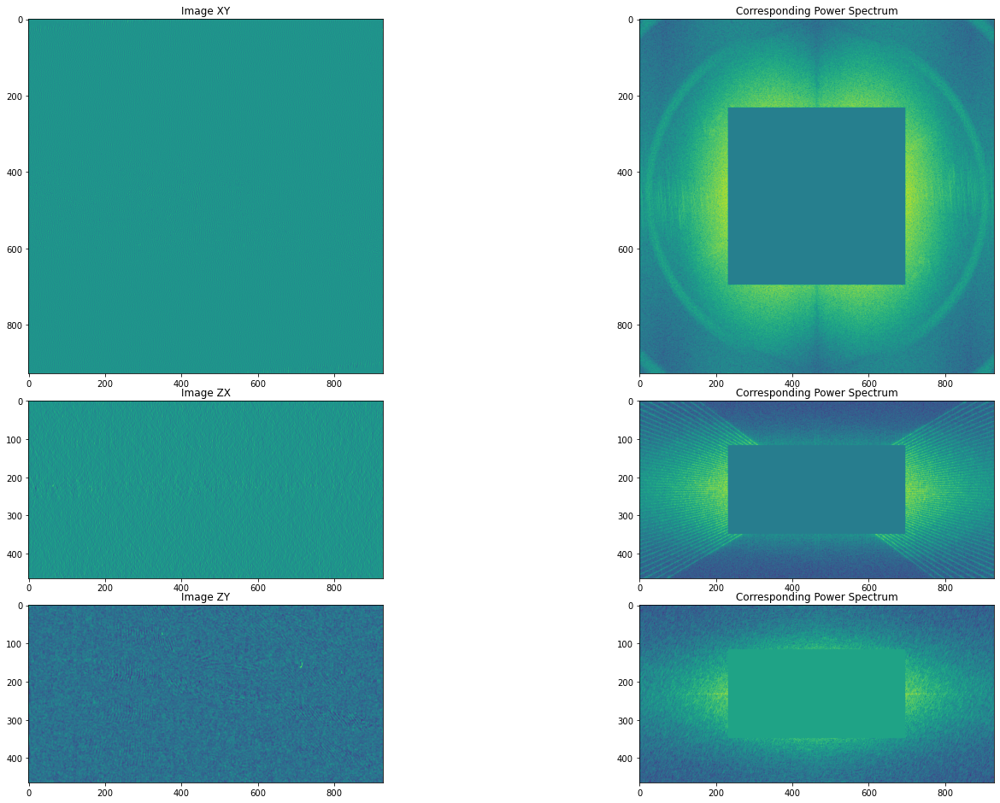

In [14]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Delete ZX slices

In [30]:
# at first the mask does nothing
msk_mesh = np.ones_like(np.real(cet[:, 0, :]))

p0 = 20 # starting point of the wedge

for dp in [10, 15, 20]: # change the width of the wedge (in degrees)

    msk_mesh = create_zeroCross(p0, dp, tomo_shape[2], tomo_shape[0])
    
    logPower_filtered = logPower_cet.copy()

    for y in range(tomo_shape[1]):
        logPower_filtered[:, y, :] *= msk_mesh

    fft_filtered = fft_cet.copy()

    for y in range(tomo_shape[1]):
        fft_filtered[:, y, :] *= msk_mesh

    cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
    cet_filtered = np.real(cet_filtered)

    filename = os.path.join(PARENT_PATH,
                            'data/simulated/tomo32_deconv_missingX_p0%d_dp%d.mrc' %(p0, dp))
    write_array(cet_filtered.astype(np.float32), filename)

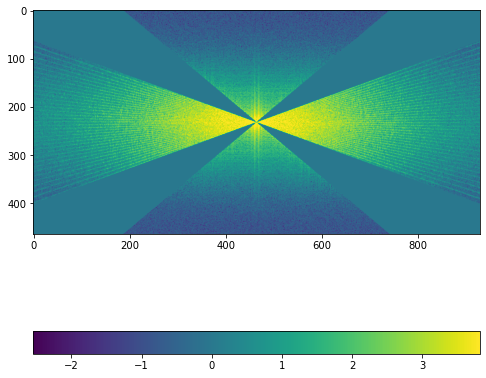

In [31]:
logPower_filtered = logPower_cet.copy()

for y in range(tomo_shape[1]):
    logPower_filtered[:, y, :] *= msk_mesh

plt.figure(figsize=(8, 12))
plt.imshow(logPower_filtered[:, tomo_shape[1]//2, :])
plt.colorbar(orientation="horizontal")

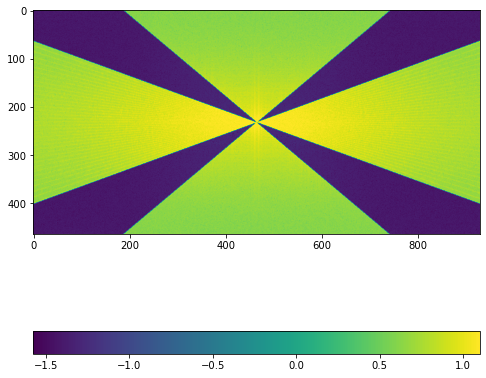

In [32]:
# Sanity check: the power of the masked cet is as expected
fft_cet2 = np.fft.fftshift(np.fft.fftn(cet_filtered))
logPower_cet2 = np.log(np.abs(fft_cet2)**2)
logPower_cet2 = clip_and_standardize(logPower_cet2, low=0.001, high=0.999)

plt.figure(figsize=(8, 12))
plt.imshow(logPower_cet2[:, tomo_shape[1]//2, :])
plt.colorbar(orientation="horizontal")

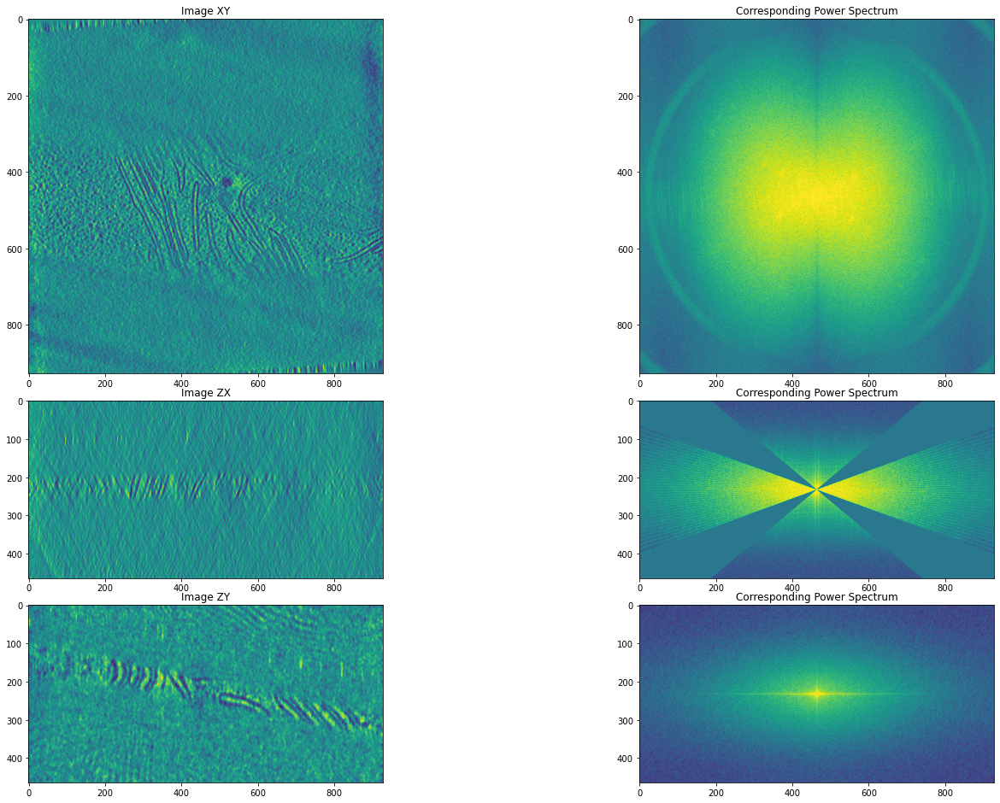

In [33]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Delete Cross at different $\theta$

In [5]:
tomo_shape = cet.shape

Effect of missing cross at 0 degrees.


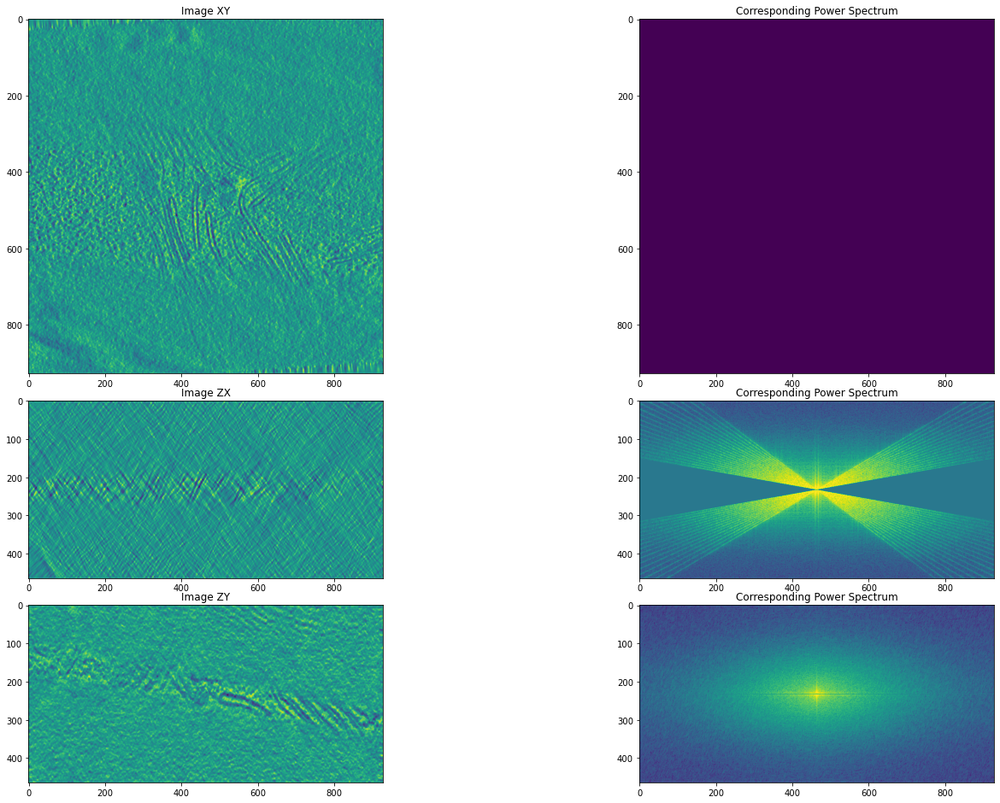

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 10 degrees.


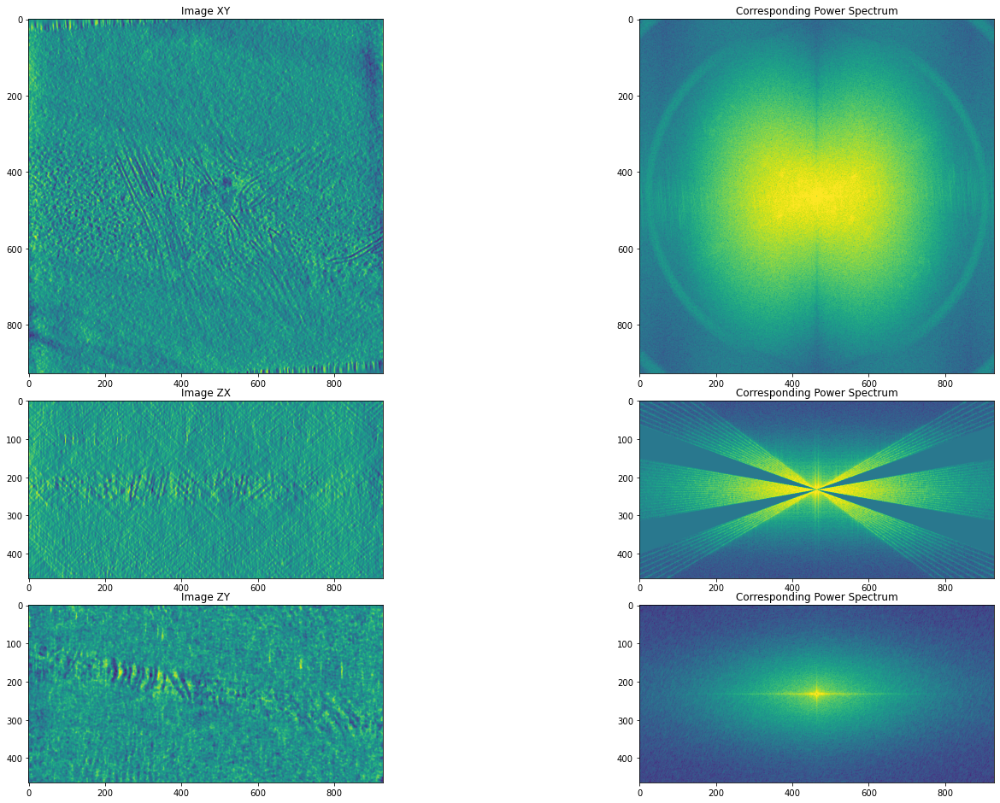

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 20 degrees.


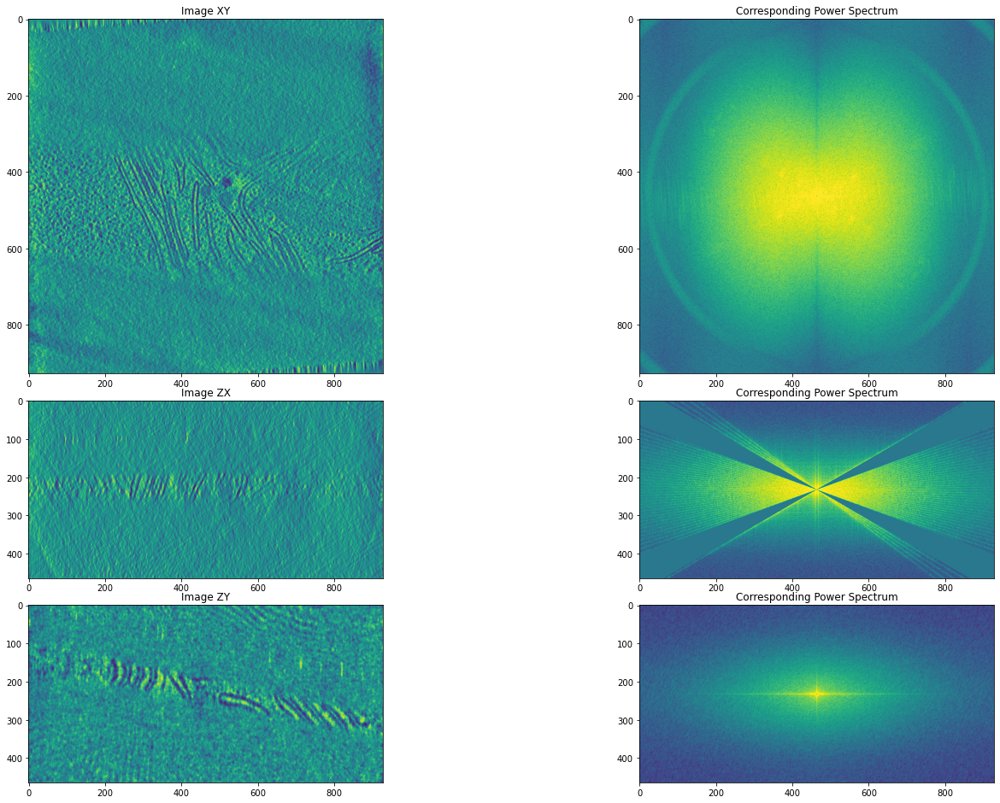

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 30 degrees.


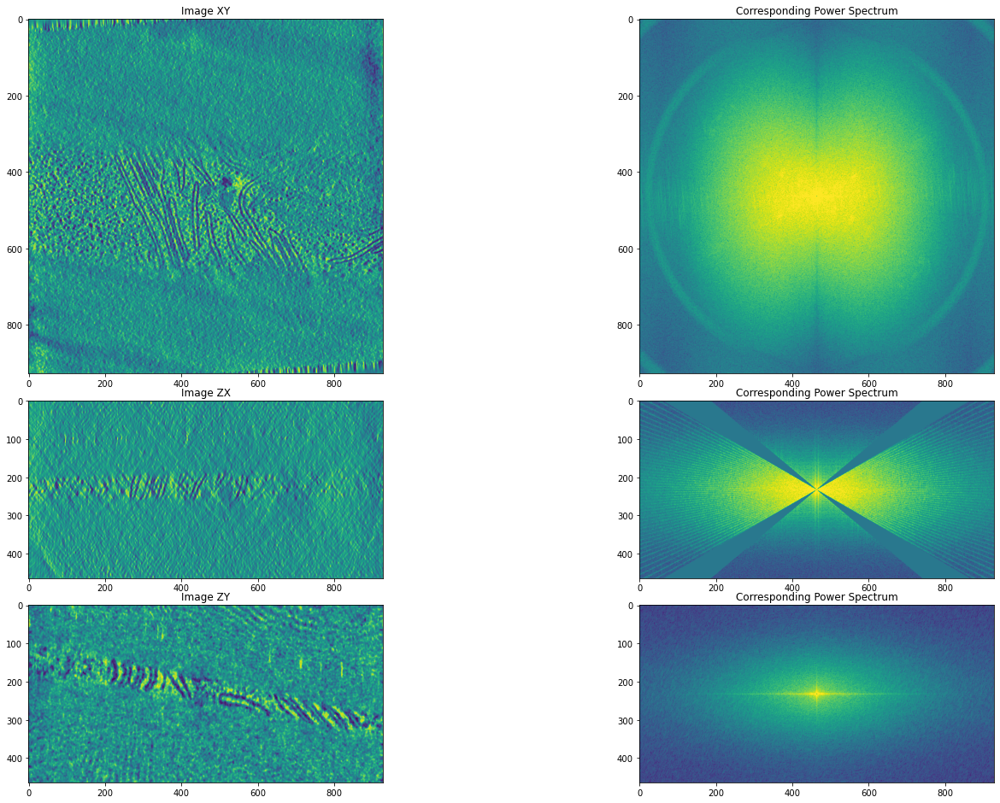

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 40 degrees.


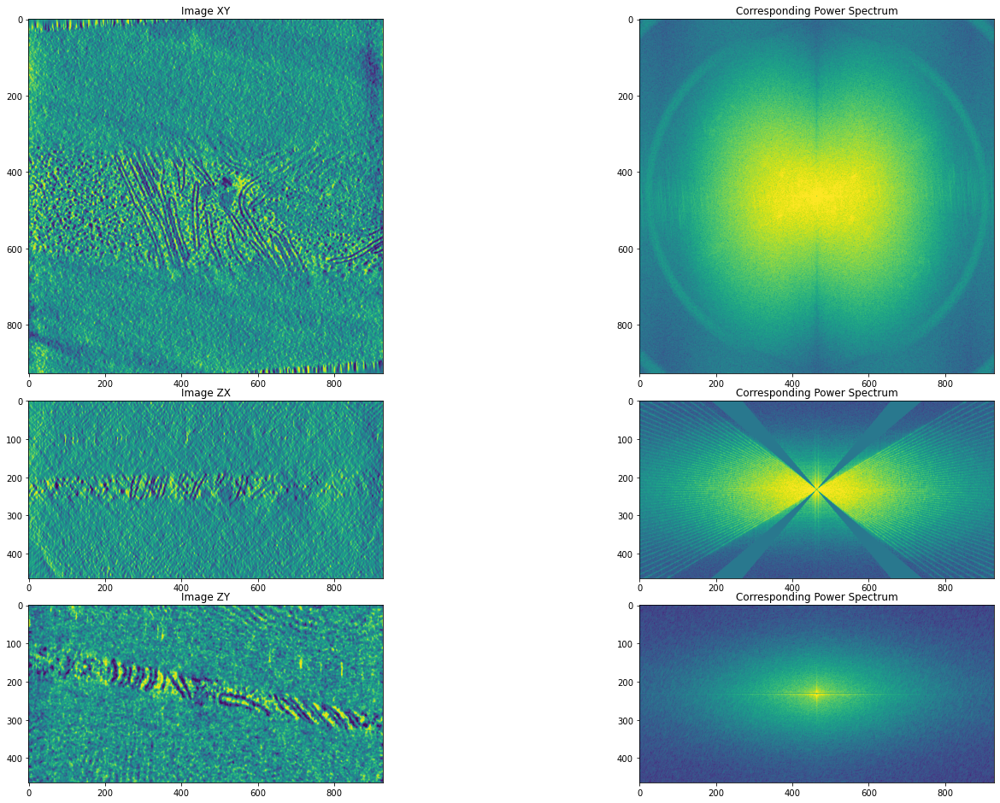

------------------------------------------------------------------------------------------------------------------------------------------



In [25]:
############## Rotate cross and plot ######################

for deg in range(0, 50, 10):
    print('Effect of missing cross at %d degrees.' %deg)
    msk_mesh = create_zeroCross(deg, 10, tomo_shape[2], tomo_shape[0])
    
    logPower_filtered = logPower_cet.copy()

    for y in range(tomo_shape[1]):
        logPower_filtered[:, y, :] *= msk_mesh

    fft_filtered = fft_cet.copy()

    for y in range(tomo_shape[1]):
        fft_filtered[:, y, :] *= msk_mesh

    cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
    cet_filtered = np.real(cet_filtered)
    
    fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
    plt.tight_layout()

    ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
    ax[0][0].set_title('Image XY')

    ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
    ax[0][1].set_title('Corresponding Power Spectrum')

    ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
    ax[1][0].set_title('Image ZX')

    ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
    ax[1][1].set_title('Corresponding Power Spectrum')

    ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
    ax[2][0].set_title('Image ZY')

    ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
    ax[2][1].set_title('Corresponding Power Spectrum')


    plt.show()
    
    print('------------------------------------------------------------------------------------------------------------------------------------------\n')

# Fourier Coefficients raw cET: Salmonella cells

## Full tomogram

In [34]:
cet = os.path.join(ISONET_PATH, 'salmonella_dataset/tomos_deconv/20200213_GW214_tgt4_ali.mrc')
cet = clip_and_standardize(read_array(cet))
tomo_shape = cet.shape
print(tomo_shape)

(420, 1440, 1024)


In [35]:
fft_cet = np.fft.fftshift(np.fft.fftn(cet))
logPower_cet = np.log(np.abs(fft_cet)**2)
logPower_cet = clip_and_standardize(logPower_cet, low=0.001, high=0.999)

(array([4.57272700e+06, 2.76954420e+07, 1.39143006e+08, 2.31955363e+08,
        1.15043158e+08, 4.66812860e+07, 2.51928500e+07, 1.51155580e+07,
        9.14782000e+06, 4.76799000e+06]),
 array([-2.60341151, -1.92539254, -1.24737356, -0.56935458,  0.1086644 ,
         0.78668338,  1.46470236,  2.14272133,  2.82074031,  3.49875929,
         4.17677827]),
 <BarContainer object of 10 artists>)

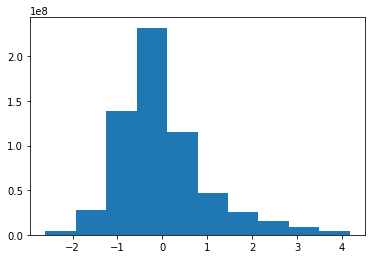

In [97]:
plt.hist(logPower_cet.flatten())

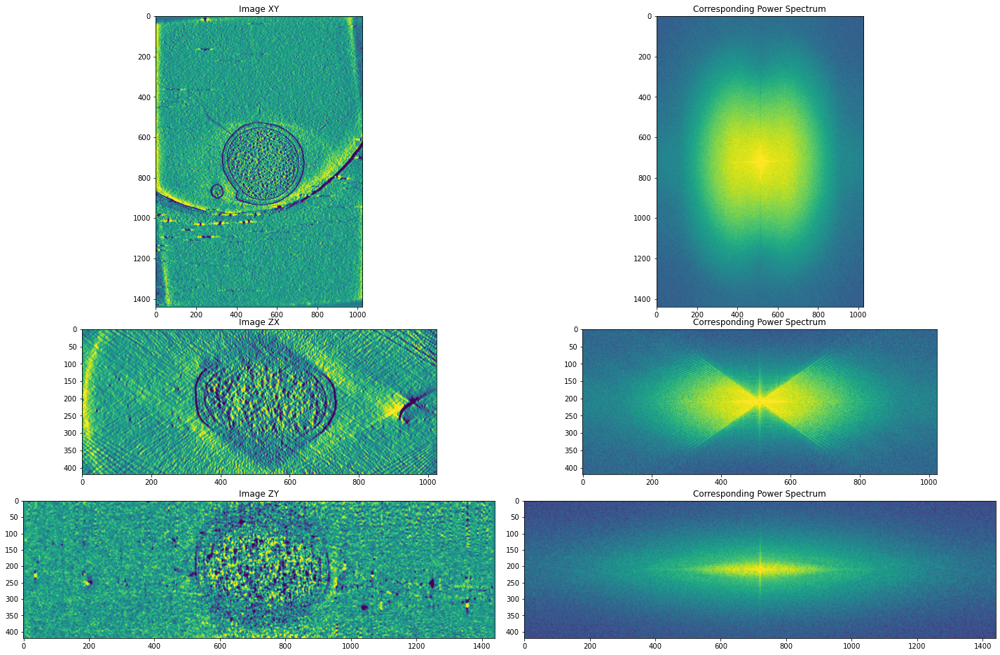

In [98]:
tomo_shape = cet.shape

fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_cet[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_cet[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_cet[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

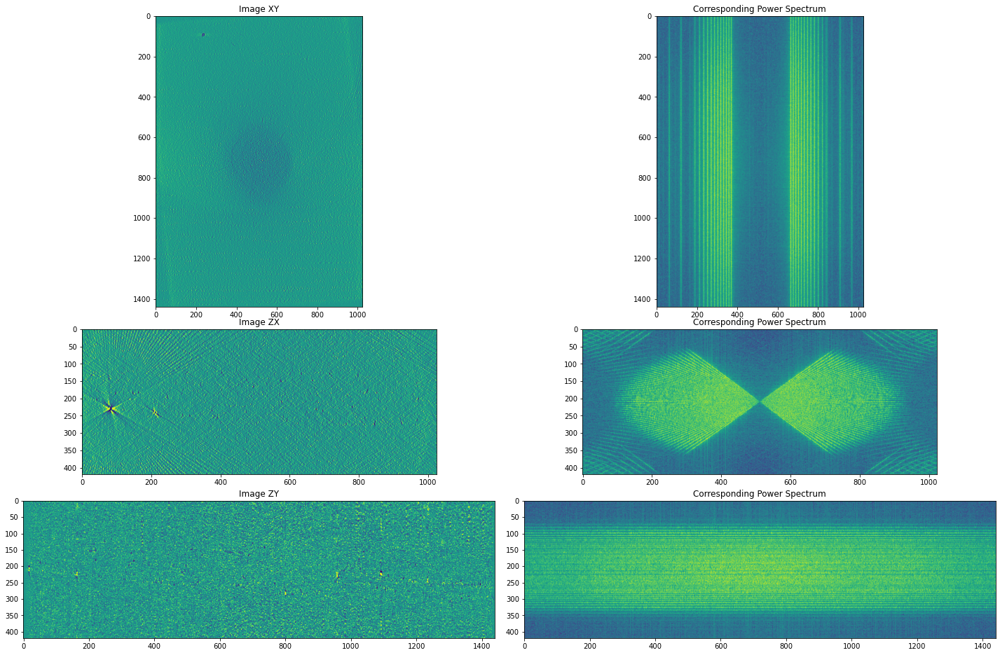

In [26]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet[tomo_shape[0]//4])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_cet[tomo_shape[0]//4])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet[:, tomo_shape[1]//4, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_cet[:, tomo_shape[1]//4, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet[:, :, tomo_shape[2]//4])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_cet[:, :, tomo_shape[2]//4])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

(array([  1065.,   3712.,  16646.,  63324., 122071.,  77995.,  50617.,
         45172.,  32394.,  17084.]),
 array([-2.83553128, -2.26767494, -1.6998186 , -1.13196227, -0.56410593,
         0.00375041,  0.57160675,  1.13946308,  1.70731942,  2.27517576,
         2.84303209]),
 <BarContainer object of 10 artists>)

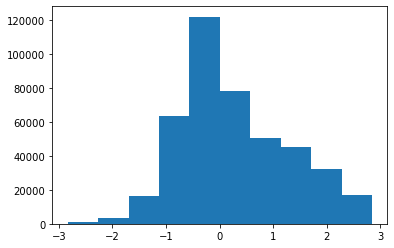

In [18]:
plt.hist(logPower_cet[:, tomo_shape[1]//2, :].flatten())

(array([  1813.,   7034.,  30906., 106671., 148576., 109466., 209746.,
        378630., 359246., 122472.]),
 array([-2.83553128, -2.26767494, -1.6998186 , -1.13196227, -0.56410593,
         0.00375041,  0.57160675,  1.13946308,  1.70731942,  2.27517576,
         2.84303209]),
 <BarContainer object of 10 artists>)

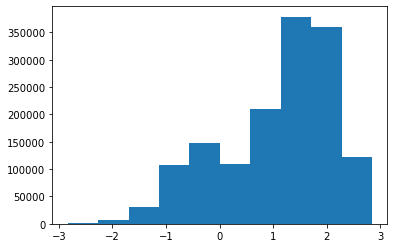

In [19]:
plt.hist(logPower_cet[tomo_shape[0]//2].flatten())

## FFT distribution on Annulus

In [48]:
tomo_shape = cet.shape

yidx = tomo_shape[1]//2
annulus_mesh = np.zeros_like(cet[:, 0, :])

angles = []
logPower_list = []
power_list = []
rs = []

delta_r = 1

annulus_inner = 20
annulus_outer = annulus_inner+delta_r

for zidx, z in enumerate(range(-tomo_shape[0]//2, tomo_shape[0]//2)):
    for xidx, x in enumerate(range(-tomo_shape[2]//2, tomo_shape[2]//2)):
        r = np.linalg.norm([z, x])
        
        phi = np.arctan2(z, x)
        phi = (2*np.pi+phi)%(2*np.pi)
        
        if r>annulus_inner and r<annulus_outer:
            annulus_mesh[zidx, xidx] = 1
            angles.append(phi)
            lp = logPower_cet[zidx, yidx, xidx]
            logPower_list.append(lp)
            power_list.append(np.exp(lp))

(array([ 6.,  8.,  8.,  6.,  8., 14., 12.,  8.,  2., 40.]),
 array([ 6.43112356, 12.30357128, 18.17601901, 24.04846673, 29.92091445,
        35.79336218, 41.6658099 , 47.53825763, 53.41070535, 59.28315307,
        65.1556008 ]),
 <BarContainer object of 10 artists>)

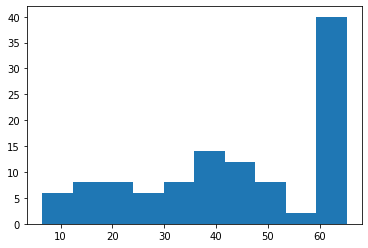

In [55]:
# Magnitude of the coefficients do not follow a Rayleigh distribution in our case
plt.hist(power_list)

(array([ 4.,  0.,  2.,  4.,  6., 10.,  8., 12., 22., 44.]),
 array([1.86114926, 2.09271216, 2.32427506, 2.55583796, 2.78740086,
        3.01896376, 3.25052666, 3.48208957, 3.71365247, 3.94521537,
        4.17677827]),
 <BarContainer object of 10 artists>)

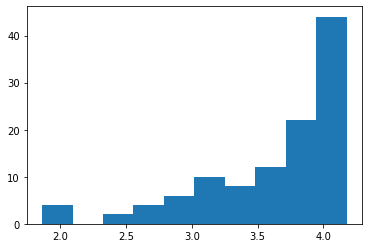

In [56]:
plt.hist(logPower_list)

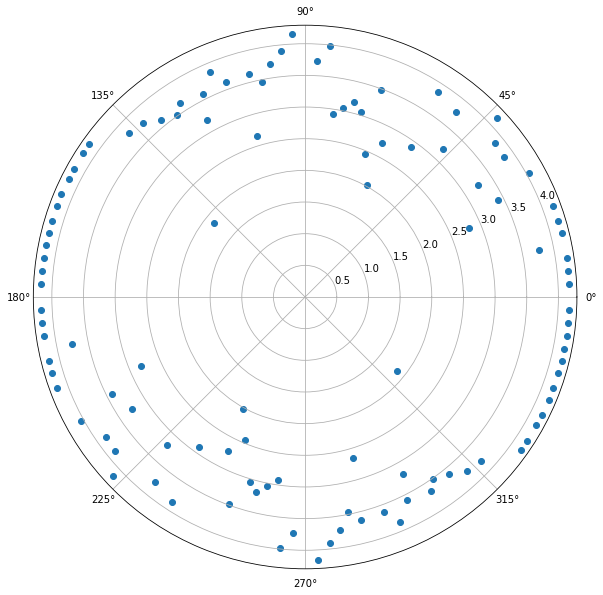

In [51]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(12,10))
ax.scatter(angles, logPower_list)
ax.grid(True)
plt.show()

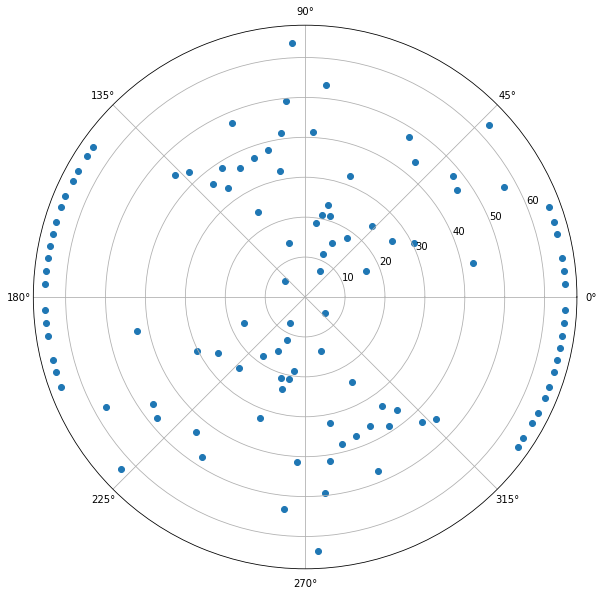

In [52]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(12,10))
ax.scatter(angles, power_list)
ax.grid(True)
plt.show()

In [53]:
aux = logPower_cet[:, yidx, :]*annulus_mesh

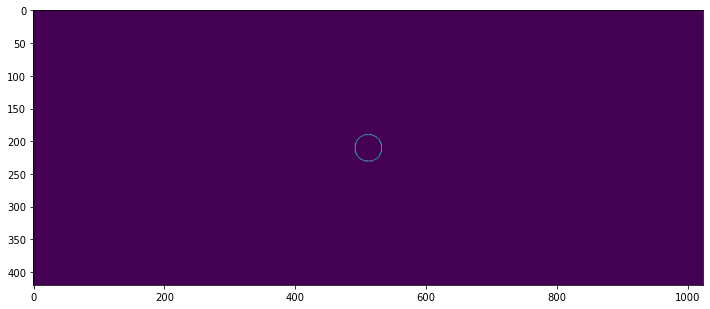

In [54]:
plt.figure(figsize=(12, 10))
plt.imshow(aux)

## Only using low frequency parts of the spectrum to reconstruct image 

In [43]:
mask = np.zeros_like(cet)
mask[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4] = 1

logPower_filtered = mask*logPower_cet
fft_filtered = mask*fft_cet

# logPower_filtered = logPower_cet[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4]
# fft_filtered = fft_cet[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4]

cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

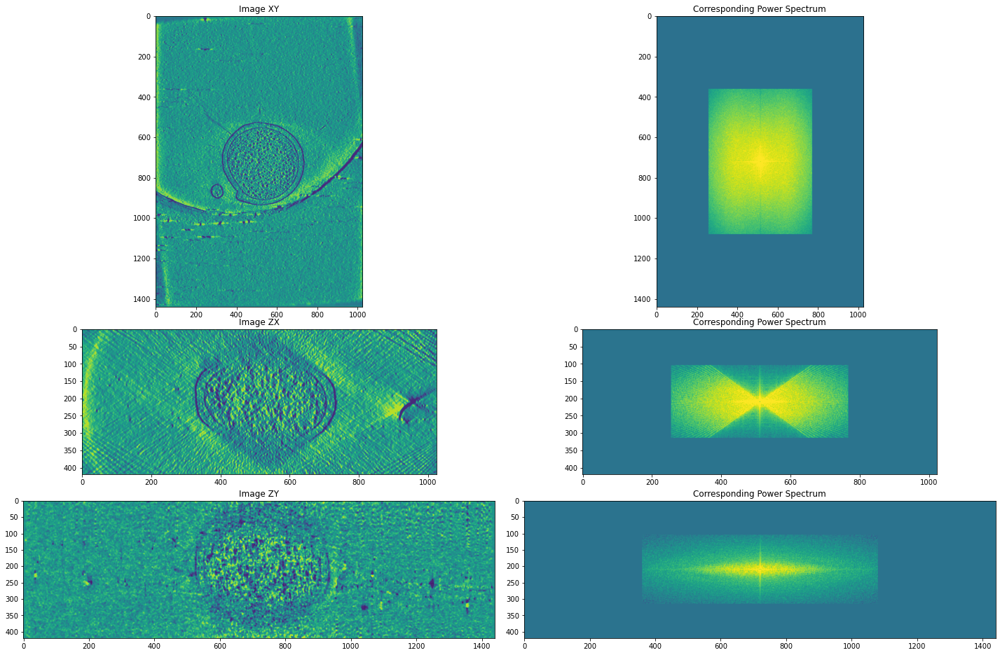

In [44]:
tomo_shape2 = cet_filtered.shape
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape2[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape2[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape2[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape2[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape2[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape2[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Only using high frequency parts of the spectrum to reconstruct image 

In [45]:
mask = np.ones_like(cet)
mask[tomo_shape[0]//4:3*tomo_shape[0]//4, tomo_shape[1]//4:3*tomo_shape[1]//4, tomo_shape[2]//4:3*tomo_shape[2]//4] = 0

logPower_filtered = mask*logPower_cet

fft_filtered = mask*fft_cet
cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
cet_filtered = np.real(cet_filtered)

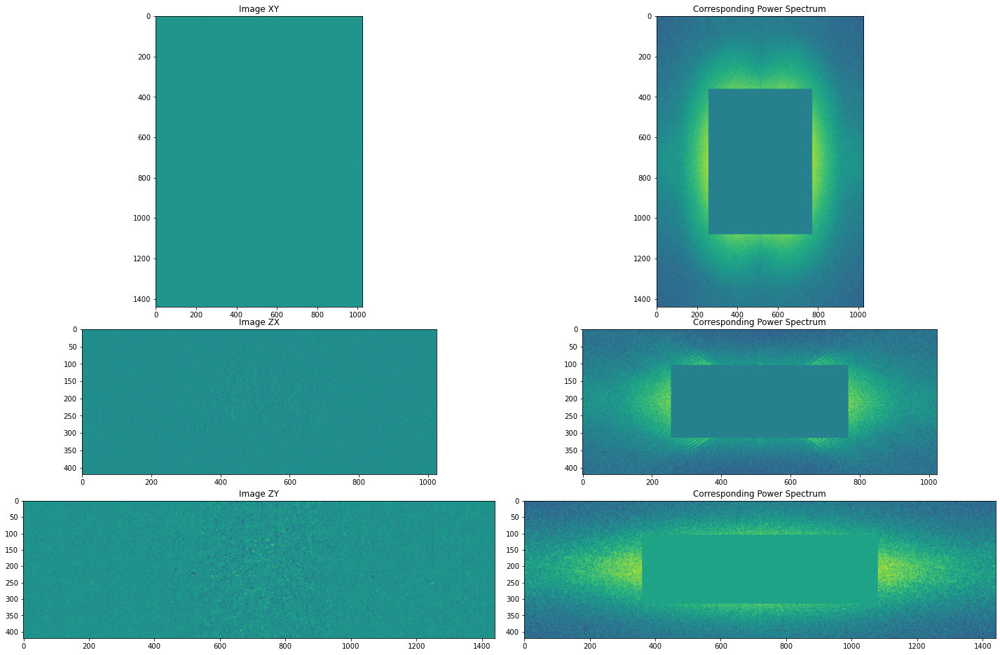

In [46]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Delete ZX slices

In [57]:
# at first the mask does nothing
msk_mesh = np.ones_like(np.real(cet[:, 0, :]))

p0 = 15 # starting point of the wedge

for dp in [10, 15, 20]: # change the width of the wedge (in degrees)

    msk_mesh = create_zeroCross(p0, dp, tomo_shape[2], tomo_shape[0])

    logPower_filtered = logPower_cet.copy()

    for y in range(tomo_shape[1]):
        logPower_filtered[:, y, :] *= msk_mesh

    fft_filtered = fft_cet.copy()

    for y in range(tomo_shape[1]):
        fft_filtered[:, y, :] *= msk_mesh

    cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
    cet_filtered = np.real(cet_filtered)

    filename = os.path.join(PARENT_PATH,
                            'data/simulated/20200213_GW214_tgt4_ali_deconv_missingX%d_%d.mrc' %(p0, dp))
    write_array(cet_filtered.astype(np.float32), filename)

In [58]:


# plt.figure(figsize=(8, 12))
# plt.imshow(logPower_filtered[:, tomo_shape[1]//2, :])
# plt.colorbar(orientation="horizontal")

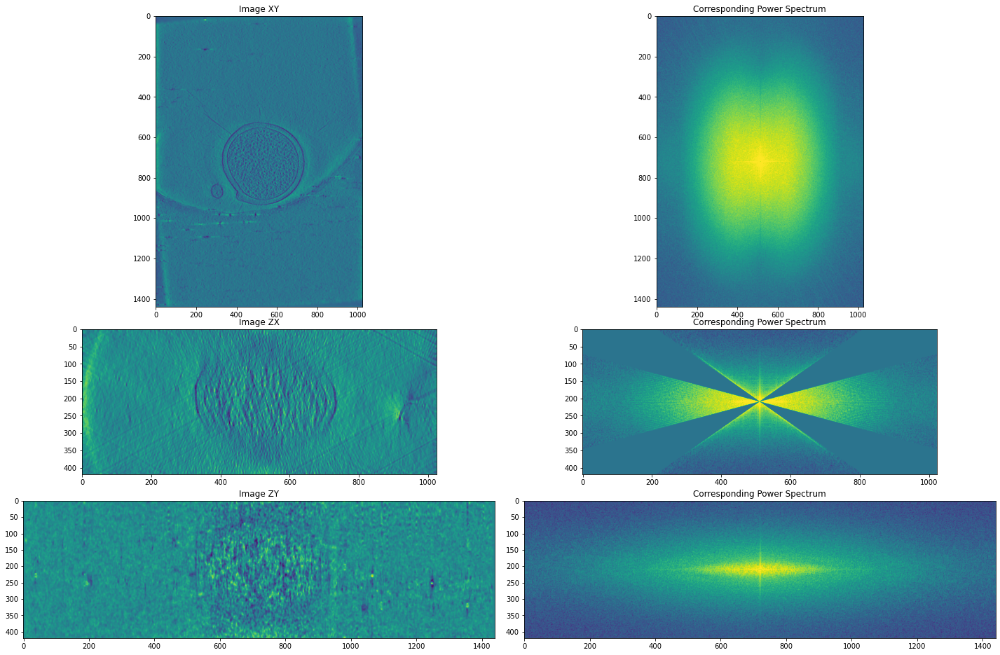

In [59]:
fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
plt.tight_layout()

ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
ax[0][0].set_title('Image XY')

ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
ax[0][1].set_title('Corresponding Power Spectrum')

ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
ax[1][0].set_title('Image ZX')

ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
ax[1][1].set_title('Corresponding Power Spectrum')

ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
ax[2][0].set_title('Image ZY')

ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
ax[2][1].set_title('Corresponding Power Spectrum')


plt.show()

## Delete Cross at different $\theta$

Effect of missing cross at 0 degrees.


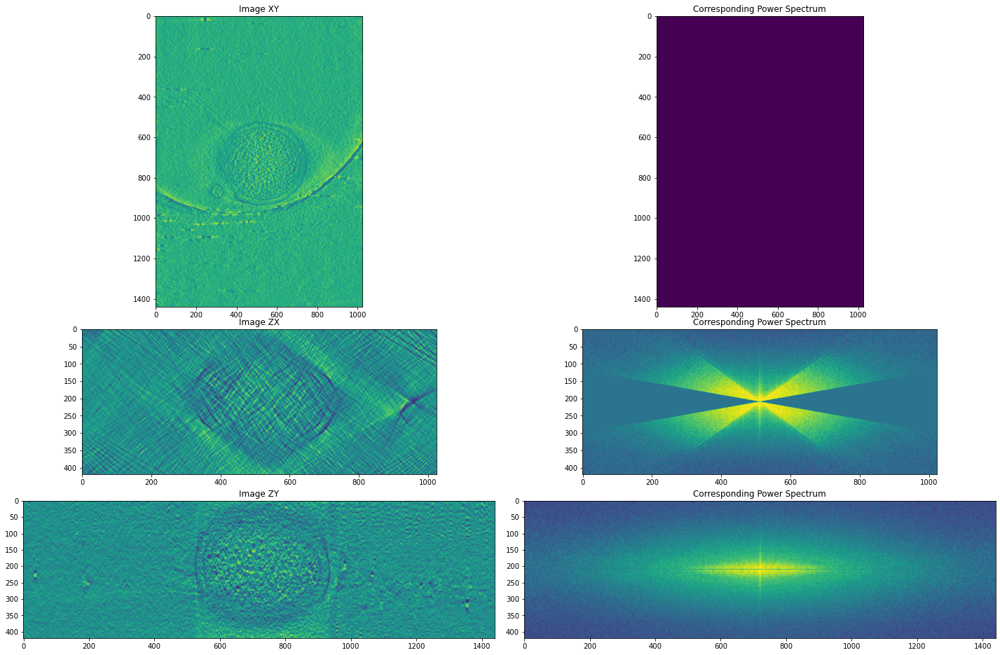

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 10 degrees.


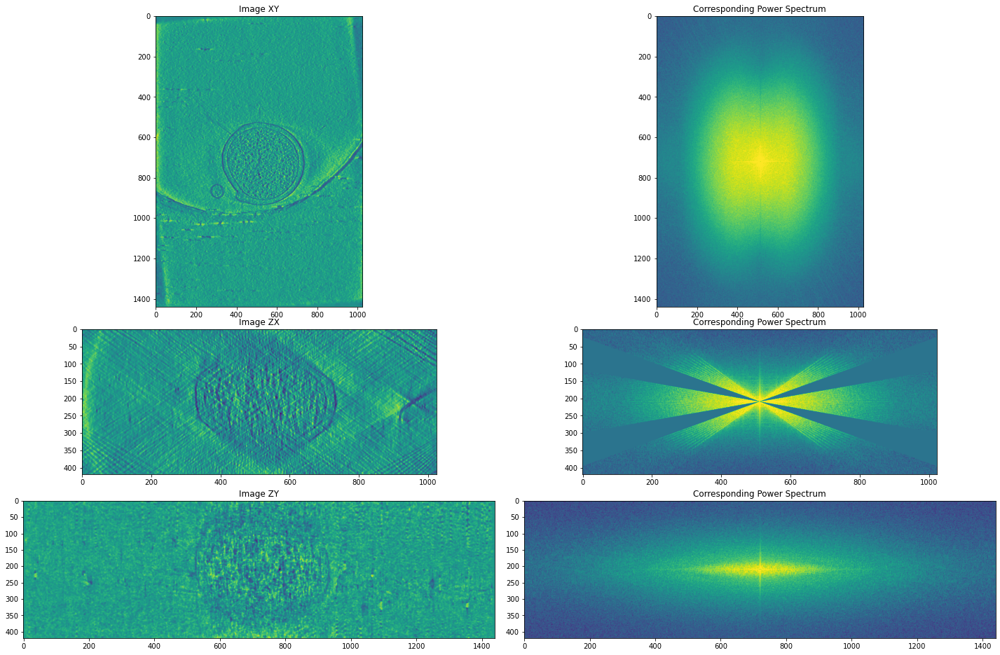

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 20 degrees.


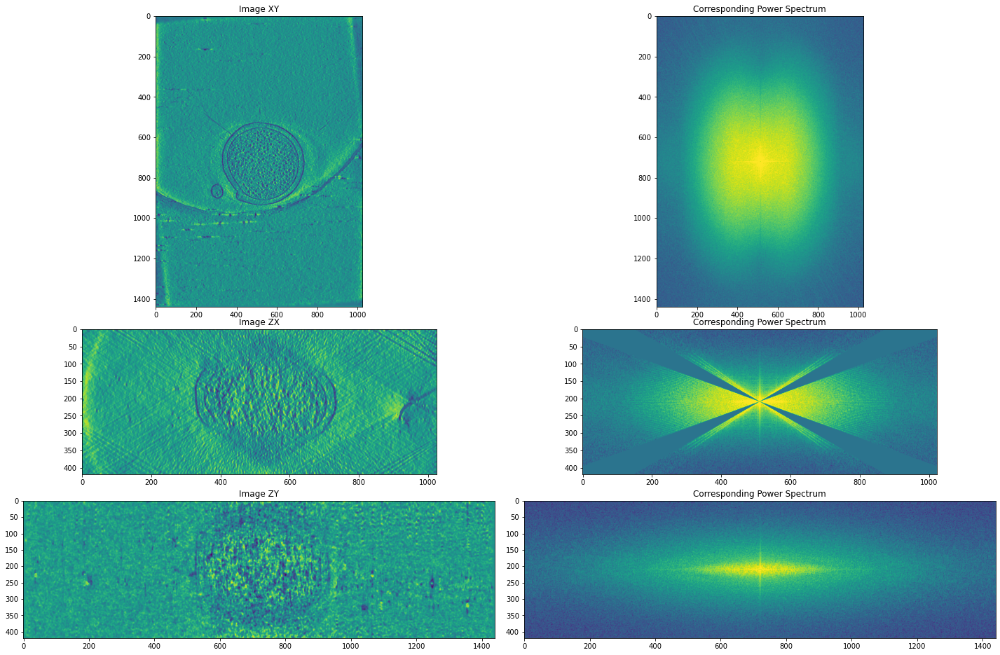

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 30 degrees.


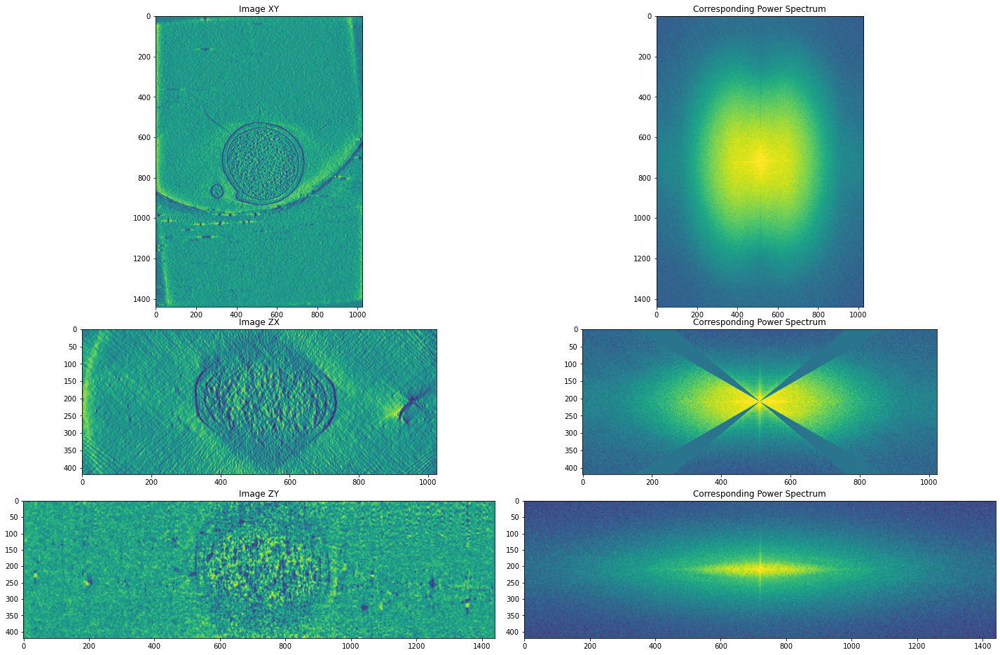

------------------------------------------------------------------------------------------------------------------------------------------

Effect of missing cross at 40 degrees.


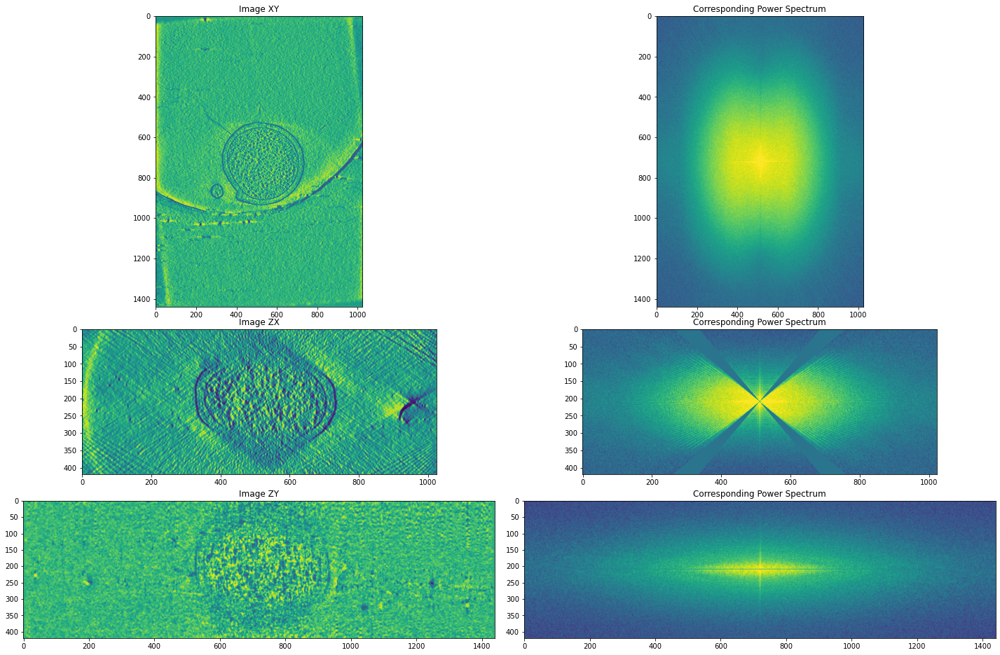

------------------------------------------------------------------------------------------------------------------------------------------



In [47]:
############## Rotate cross and plot ######################

for deg in range(0, 50, 10):
    print('Effect of missing cross at %d degrees.' %deg)
    msk_mesh = create_zeroCross(deg, 10, tomo_shape[2], tomo_shape[0])
    
    logPower_filtered = logPower_cet.copy()

    for y in range(tomo_shape[1]):
        logPower_filtered[:, y, :] *= msk_mesh

    fft_filtered = fft_cet.copy()

    for y in range(tomo_shape[1]):
        fft_filtered[:, y, :] *= msk_mesh

    cet_filtered = np.fft.ifftn(np.fft.ifftshift(fft_filtered))
    cet_filtered = np.real(cet_filtered)
    
    fig, ax = plt.subplots(3, 2, figsize=(20, 13), gridspec_kw={'height_ratios': [2, 1, 1]})  
    plt.tight_layout()

    ax[0][0].imshow(cet_filtered[tomo_shape[0]//2])
    ax[0][0].set_title('Image XY')

    ax[0][1].imshow(logPower_filtered[tomo_shape[0]//2])
    ax[0][1].set_title('Corresponding Power Spectrum')

    ax[1][0].imshow(cet_filtered[:, tomo_shape[1]//2, :])
    ax[1][0].set_title('Image ZX')

    ax[1][1].imshow(logPower_filtered[:, tomo_shape[1]//2, :])
    ax[1][1].set_title('Corresponding Power Spectrum')

    ax[2][0].imshow(cet_filtered[:, :, tomo_shape[2]//2])
    ax[2][0].set_title('Image ZY')

    ax[2][1].imshow(logPower_filtered[:, :, tomo_shape[2]//2])
    ax[2][1].set_title('Corresponding Power Spectrum')


    plt.show()
    
    print('------------------------------------------------------------------------------------------------------------------------------------------\n')